In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn import metrics

In [ ]:
dataset = pd.read_csv('cars.csv')
dataset.head()

,car_ID,symboling,CarName,fueltype,aspiration,doornumber,carbody,drivewheel,enginelocation,wheelbase,...,enginesize,fuelsystem,boreratio,stroke,compressionratio,horsepower,peakrpm,citympg,highwaympg,price
0,1,3,alfa-romero giulia,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,13495.0
1,2,3,alfa-romero stelvio,gas,std,two,convertible,rwd,front,88.6,...,130,mpfi,3.47,2.68,9.0,111,5000,21,27,16500.0
2,3,1,alfa-romero Quadrifoglio,gas,std,two,hatchback,rwd,front,94.5,...,152,mpfi,2.68,3.47,9.0,154,5000,19,26,16500.0
3,4,2,audi 100 ls,gas,std,four,sedan,fwd,front,99.8,...,109,mpfi,3.19,3.40,10.0,102,5500,24,30,13950.0
4,5,2,audi 100ls,gas,std,four,sedan,4wd,front,99.4,...,136,mpfi,3.19,3.40,8.0,115,5500,18,22,17450.0


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 205 entries, 0 to 204
Data columns (total 26 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   car_ID            205 non-null    int64  
 1   symboling         205 non-null    int64  
 2   CarName           205 non-null    object 
 3   fueltype          205 non-null    object 
 4   aspiration        205 non-null    object 
 5   doornumber        205 non-null    object 
 6   carbody           205 non-null    object 
 7   drivewheel        205 non-null    object 
 8   enginelocation    205 non-null    object 
 9   wheelbase         205 non-null    float64
 10  carlength         205 non-null    float64
 11  carwidth          205 non-null    float64
 12  carheight         205 non-null    float64
 13  curbweight        205 non-null    int64  
 14  enginetype        205 non-null    object 
 15  cylindernumber    205 non-null    object 
 16  enginesize        205 non-null    int64  
 1

In [ ]:
dataset.describe

<bound method NDFrame.describe of      car_ID  symboling                   CarName fueltype aspiration  \
0         1          3        alfa-romero giulia      gas        std   
1         2          3       alfa-romero stelvio      gas        std   
2         3          1  alfa-romero Quadrifoglio      gas        std   
3         4          2               audi 100 ls      gas        std   
4         5          2                audi 100ls      gas        std   
..      ...        ...                       ...      ...        ...   
200     201         -1           volvo 145e (sw)      gas        std   
201     202         -1               volvo 144ea      gas      turbo   
202     203         -1               volvo 244dl      gas        std   
203     204         -1                 volvo 246   diesel      turbo   
204     205         -1               volvo 264gl      gas      turbo   

    doornumber      carbody drivewheel enginelocation  wheelbase  ...  \
0          two  convertible        rwd          front       88.6  ...   
1          two  convertible        rwd          front       88.6  ...   
2          two    hatchback        rwd          front       94.5  ...   
3         four        sedan        fwd          front       99.8  ...   
4         four        sedan        4wd          front       99.4  ...   
..         ...          ...        ...            ...        ...  ...   
200       four        sedan        rwd          front      109.1  ...   
201       four        sedan        rwd          front      109.1  ...   
202       four        sedan        rwd          front      109.1  ...   
203       four        sedan        rwd          front      109.1  ...   
204       four        sedan        rwd          front      109.1  ...   

     enginesize  fuelsystem  boreratio  stroke compressionratio horsepower  \
0           130        mpfi       3.47    2.68              9.0        111   
1           130        mpfi       3.47    2.68              9.0        111   
2           152        mpfi       2.68    3.47              9.0        154   
3           109        mpfi       3.19    3.40             10.0        102   
4           136        mpfi       3.19    3.40              8.0        115   
..          ...         ...        ...     ...              ...        ...   
200         141        mpfi       3.78    3.15              9.5        114   
201         141        mpfi       3.78    3.15              8.7        160   
202         173        mpfi       3.58    2.87              8.8        134   
203         145         idi       3.01    3.40             23.0        106   
204         141        mpfi       3.78    3.15              9.5        114   

     peakrpm citympg  highwaympg    price  
0       5000      21          27  13495.0  
1       5000      21          27  16500.0  
2       5000      19          26  16500.0  
3       5500      24          30  13950.0  
4       5500      18          22  17450.0  
..       ...     ...         ...      ...  
200     5400      23          28  16845.0  
201     5300      19          25  19045.0  
202     5500      18          23  21485.0  
203     4800      26          27  22470.0  
204     5400      19          25  22625.0  

[205 rows x 26 columns]>

In [ ]:
X = dataset.iloc[:,:-1]
y = dataset.iloc[:,-1]

In [ ]:
ct= ColumnTransformer(transformers=[('encoder', OneHotEncoder(sparse_output=False), [2,3,4,5,6,7,8,14,15,17])], remainder='passthrough')
X=np.array(ct.fit_transform(X))

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.2, random_state = 0)
X_train.shape

(164, 200)

In [ ]:
multi_regressor = LinearRegression()
multi_regressor.fit(X_train,y_train)

LinearRegression()

In [ ]:
y_pred = multi_regressor.predict(X_test)

In [ ]:
print(multi_regressor.coef_)
print(multi_regressor.intercept_)

[-3.95837660e-07  1.94958420e+04  1.77203828e+04  2.05043152e+04
  2.32016200e+04  9.14703104e+03  1.07601558e+04 -7.79226639e-09
  7.60431465e+03 -1.08658469e-08  2.90660362e+04  4.81741154e-08
  3.76943876e+04  3.76550412e+04 -2.02376214e-08  3.70991716e+04
  3.24943126e+03  2.82402459e+03  8.90964009e+03  2.86607757e+02
  3.87423562e+03  9.85892257e-09  4.16304080e+03 -9.52879599e+03
  2.02185220e-08  1.31751284e+04  1.24718719e+04 -3.02497938e-08
  9.41003141e+03  8.71409898e+03  9.14864873e+03  4.48863725e+03
  1.12938920e+04  1.53388778e+04  9.85654017e+03  1.02187519e+04
  1.26553377e+04 -2.91038305e-10  8.53737120e+03  1.07258814e+04
  6.42524208e+03  1.00120931e+04  9.73042356e+03  7.06098790e+03
  9.50072030e+03  5.09586113e+03 -2.47382559e-10  1.16010598e+04
  2.04523904e+04  1.73734579e+04  5.87102002e+03  8.14816295e+03
  6.54111494e+03  8.04687763e+03  1.73875428e+04  9.99807883e+03
  8.79534607e+03  5.76973385e+03  8.68451088e+03  7.44223599e+03
  1.89105883e+04 -4.09272

Making a single prediction (for example the profit of a startup with R&D Spend = 160000, Administration Spend = 130000, Marketing Spend = 300000 and State = 'California')

In [ ]:
print('Variance score: {}'.format(multi_regressor.score(X_test, y_test)))

Variance score: -1.4913223765995043


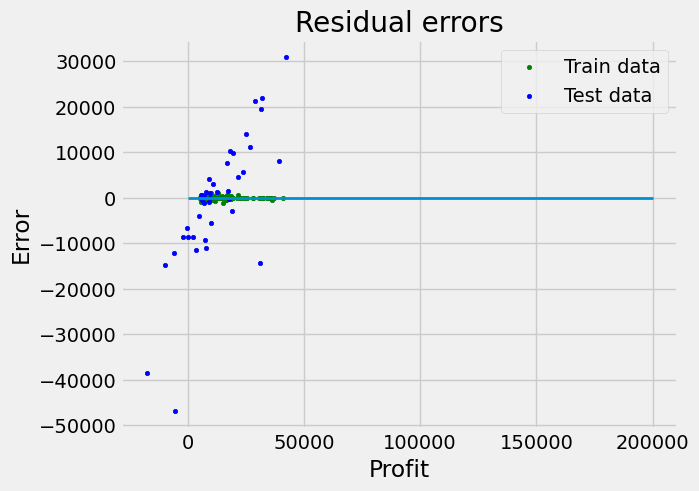

In [ ]:
plt.style.use('fivethirtyeight')
plt.scatter(multi_regressor.predict(X_train), multi_regressor.predict(X_train)-y_train, color = "green", s = 10, label = 'Train data')
plt.scatter(multi_regressor.predict(X_test), multi_regressor.predict(X_test)-y_test, color = "blue", s = 10, label = 'Test data')
plt.hlines(y = 0, xmin = 0, xmax = 200000, linewidth = 2)
plt.legend(loc = 'upper right')
plt.title("Residual errors")
plt.xlabel("Profit")
plt.ylabel("Error")
plt.show()

In [ ]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 9391.645399524768
MSE: 192869105.55378288
RMSE: 13887.732196214862


# APPLYING MULTIPLE REGRESSION ON SUBSET OF PREDICTORS

In [4]:
X = dataset.iloc[:, :15]  # Select the first 15 columns as predictors
y = dataset.iloc[:, -1]

In [5]:
ct= ColumnTransformer(transformers=[('encoder', OneHotEncoder(sparse_output=False), [2,3,4,5,6,7,8,14])], remainder='passthrough')
X=np.array(ct.fit_transform(X))

In [6]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size = 0.2, random_state = 0)
X_train.shape

(164, 177)

In [7]:
multi_regressor = LinearRegression()
multi_regressor.fit(X_train,y_train)

LinearRegression()

In [8]:
y_pred = multi_regressor.predict(X_test)

In [9]:
print(multi_regressor.coef_)
print(multi_regressor.intercept_)

[ 1.31263392e-06  9.76286890e+03  3.82343782e+03  6.73581882e+03
  8.66200540e+03  6.18901211e+03  7.91387469e+03  2.19417871e-08
  7.75861943e+03  1.75123205e-09  1.30730414e+04  1.88342710e-08
  1.81693331e+04  2.03943922e+04  3.08054950e-08  1.44330715e+04
  9.06299814e+03  7.38697524e+03  1.69489397e+04  4.63161122e+03
  1.10607831e+04 -1.85264071e-09  9.05491318e+03  4.39123166e+03
 -2.53157850e-09  6.86893014e+03  6.10050293e+03  7.68022801e-09
  5.42693594e+03  4.60255495e+03  4.47946747e+03  3.26082795e+03
  5.65132359e+03  4.98362149e+03  5.49701025e+03  6.34314791e+03
  7.60545117e+03  3.49245965e-10  3.75698877e+03  4.55655699e+03
  4.14819831e+03  5.02964041e+03  3.77345419e+03  4.06700509e+03
  3.07517774e+03  2.70892140e+03 -1.65891834e-09  3.89465689e+03
  1.61722498e+04  1.29648688e+04  1.67053501e+04  1.84862703e+03
  1.09966229e+03  1.24965950e+03  7.00095848e+03  9.91472535e+03
  2.37885006e+03 -1.74298919e+03  9.53000542e+02  3.42636263e+02
  8.67913135e+03  1.21997

In [10]:
print('Variance score: {}'.format(multi_regressor.score(X_test, y_test)))

Variance score: -0.007404399595128064


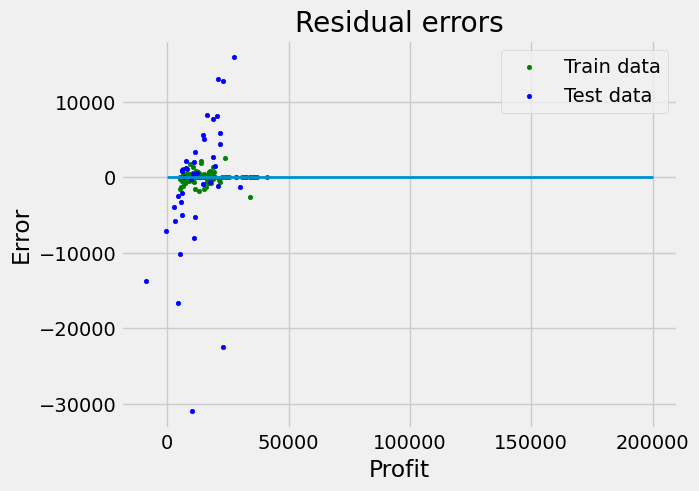

In [11]:
plt.style.use('fivethirtyeight')
plt.scatter(multi_regressor.predict(X_train), multi_regressor.predict(X_train)-y_train, color = "green", s = 10, label = 'Train data')
plt.scatter(multi_regressor.predict(X_test), multi_regressor.predict(X_test)-y_test, color = "blue", s = 10, label = 'Test data')
plt.hlines(y = 0, xmin = 0, xmax = 200000, linewidth = 2)
plt.legend(loc = 'upper right')
plt.title("Residual errors")
plt.xlabel("Profit")
plt.ylabel("Error")
plt.show()

In [12]:
print('MAE:', metrics.mean_absolute_error(y_test, y_pred))
print('MSE:', metrics.mean_squared_error(y_test, y_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

MAE: 5968.132139178344
MSE: 77989579.87366584
RMSE: 8831.170923137308


# **POLYNOMIAL REGRESSION**





In [ ]:
poly = PolynomialFeatures(degree=3)
X_poly_train = poly.fit_transform(X_train)
X_poly_test = poly.transform(X_test)

In [ ]:
poly_regressor = LinearRegression()
poly_regressor.fit(X_poly_train, y_train)

LinearRegression()

In [ ]:
y_poly = poly_regressor.predict(poly.fit_transform(X_test))

In [ ]:
print(poly_regressor.coef_)
print(poly_regressor.intercept_)

[ 5.99033699e-14  2.07324945e-14  1.69860067e-12 -1.85732756e-12
  1.80059320e-12  5.54816629e-12  1.10449865e-12  1.59917661e-12
 -2.12014464e-16 -1.44121190e-12  9.99967838e-15  2.65520336e-12
  1.44000006e-15  8.49675672e-12 -1.23396416e-12 -1.15422385e-14
  8.09829416e-12  9.88153167e-12  1.57753839e-12  1.60055855e-12
  2.33189099e-12 -2.52276487e-12  2.46703428e-16 -5.01846336e-12
 -1.28632045e-12 -9.34975296e-16 -3.23999517e-12 -2.87445071e-12
 -1.26519617e-16  5.20543253e-13 -3.84869709e-13  2.66501132e-12
  2.26457967e-13  2.85646026e-12  6.02856724e-12 -3.14789972e-13
 -2.22225189e-12 -1.82959024e-13  1.07607066e-17 -1.23680119e-12
  1.98637432e-12  1.06207032e-12 -6.70388764e-13 -1.47795710e-12
 -1.17663101e-12 -1.10641221e-12  2.20027243e-12  2.84765701e-16
  3.30915256e-12 -1.28137684e-12 -3.98793500e-12  4.25030299e-12
  2.74591938e-12  2.20647071e-12  5.69098131e-12  6.66797254e-12
  2.76026045e-12  8.79539836e-12  9.94996973e-13  8.39496763e-12
  3.63216963e-12  4.46137

In [ ]:
print('Variance score:', poly_regressor.score(X_poly_test, y_test))

Variance score: 0.40215650078808496


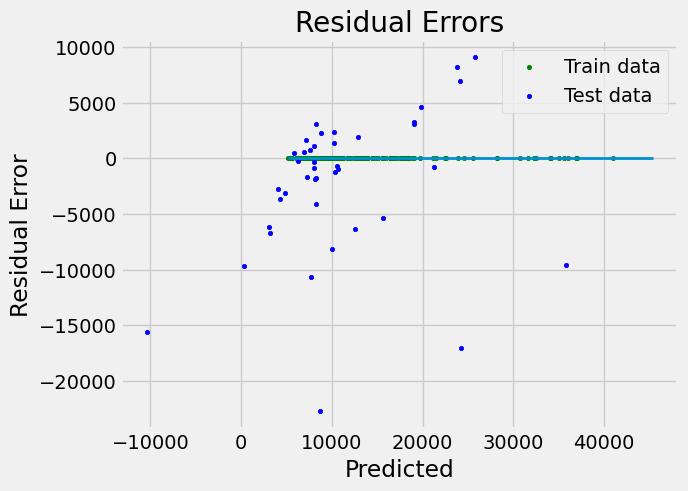

In [ ]:
plt.style.use('fivethirtyeight')
plt.scatter(poly_regressor.predict(X_poly_train), poly_regressor.predict(X_poly_train) - y_train, color="green", s=10, label='Train data')
plt.scatter(poly_regressor.predict(X_poly_test), poly_regressor.predict(X_poly_test) - y_test, color="blue", s=10, label='Test data')
plt.hlines(y=0, xmin=min(y), xmax=max(y), linewidth=2)
plt.legend(loc='upper right')
plt.title("Residual Errors")
plt.xlabel("Predicted")
plt.ylabel("Residual Error")
plt.show()

In [ ]:
print('MAE:', metrics.mean_absolute_error(y_test, y_poly))
print('MSE:', metrics.mean_squared_error(y_test, y_poly))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, y_poly)))

MAE: 4699.311434409282
MSE: 46282866.49579668
RMSE: 6803.151218060399
